## Mantener envolvente espectral

In [118]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import io, signal
from scipy.linalg import solve_toeplitz
from scipy.io.wavfile import read
from IPython.display import Audio
from  matplotlib import patches
from matplotlib.pyplot import axvline, axhline
from scipy.linalg import toeplitz
from scipy.linalg import solve

dir_files = './data/'

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import IPython.display as ipd
from synctoolbox.dtw.mrmsdtw import sync_via_mrmsdtw
from synctoolbox.dtw.utils import compute_optimal_chroma_shift, shift_chroma_vectors, make_path_strictly_monotonic, evaluate_synchronized_positions
from synctoolbox.feature.chroma import pitch_to_chroma, quantize_chroma, quantized_chroma_to_CENS
from synctoolbox.feature.dlnco import pitch_onset_features_to_DLNCO
from synctoolbox.feature.pitch import audio_to_pitch_features
from synctoolbox.feature.pitch_onset import audio_to_pitch_onset_features
from synctoolbox.feature.utils import estimate_tuning

In [119]:
def cargar_audio(directorio, nombre, mono=False):
    # Cargar audio
    sr, data = io.wavfile.read(directorio+nombre)

    if mono:
        # Pasar de estéreo a mono
        if len(data.shape) > 1:
            data = (data[:,0].astype(float) + data[:,1].astype(float))/2

    # normalize maximum (absolute) amplitude
    data = data / np.max(abs(data)) * 0.9

    return sr, data

In [66]:
## 1. Obtencion de las formantes
def lpc_analysis(s, p):
    """ compute the LPC analysis using the autocorrelation method

    Parameters
    ----------
    x : numpy array
        windowed signal frame as a numpy 1D array.
    p : int
        model order.

    Returns
    -------
    ak : numpy array
         model coefficients.
    e : float
        minimum mean squared error.
    e_norm : float
             normalized minimum mean squared error.
    """
    # frame length
    N = s.shape[0]

    # compute autocorrelation values
    r = np.zeros((p+1, 1))
    for k in range(p+1):
        r[k] = np.dot(s[:N-k].T, s[k:N])

    # solve to compute model coefficients
    ak = solve(toeplitz(r[0:p]), r[1:p+1]).squeeze()
    
    # compute mean squared error
    e = r[0] - np.dot(ak.T, r[ 1:p+1])


    # compute normalized mean squared error
    e_norm = e / r[0]

    return ak, e, e_norm

In [129]:
def get_envolvente(audio,sr):

    # number of samples in window
    N = 550

    # initial sample of the audio frame
    ind_ini = (len(audio) -N)//2

    # signal frame
    s = audio[ind_ini:ind_ini+N]

    # smoothing window
    window = signal.windows.get_window('hann', N)

    # windowed signal frame
    s_win  = s  * window

    # number of DFT points
    Ndft = 4056

    # spectrum of the signal frame
    X  = np.fft.fft(s_win, Ndft)
    # frequency values
    f  = np.fft.fftfreq(Ndft) * sr

    # model order
    p = sr//1000

    # apply lpc analysis to signal frame
    ak , e , e_norm = lpc_analysis(s_win , p)

    # filter obtained from the lpc analysis
    S = 1
    U  = np.concatenate([[1], -ak ])

    # compute gain
    G  = np.sqrt(e )

    # compute the frequency response of the digital filter
    w , H  = signal.freqz(G *S, U , worN=Ndft, whole=True)
    fw  = w  / (2 * np.pi) * sr

    # # impulse response of the LPC filter
    # delta = np.zeros(N)
    # delta[0] = 1
    # h_emily_shft  = signal.lfilter(G_emily_shft *S, U_emily_shft , delta)
    return H, X,f

In [109]:
# number of samples in window
N = 550

# initial sample of the audio frame
ind_ini = (len(data) -N)//2

# signal frame
s = data[ind_ini:ind_ini+N]

# smoothing window
window = signal.windows.get_window('hann', N)

# windowed signal frame
s_win = s * window

# number of DFT points
Ndft = 4056

# spectrum of the signal frame
X = np.fft.fft(s_win, Ndft)
# frequency values
f = np.fft.fftfreq(Ndft) * fs

In [111]:
# model order
p = fs//1000

# apply lpc analysis to signal frame
ak, e, e_norm = lpc_analysis(s_win, p)

# filter obtained from the lpc analysis
S = 1
U = np.concatenate([[1], -ak])

# compute gain
G = np.sqrt(e)

# compute the frequency response of the digital filter
w, H = signal.freqz(G*S, U, worN=Ndft, whole=True)
fw = w / (2 * np.pi) * fs

# impulse response of the LPC filter
delta = np.zeros(N)
delta[0] = 1
h = signal.lfilter(G*S, U, delta)

In [130]:
fs, data = cargar_audio(dir_files, 'Emily_Linge-vocals.wav', mono=True)

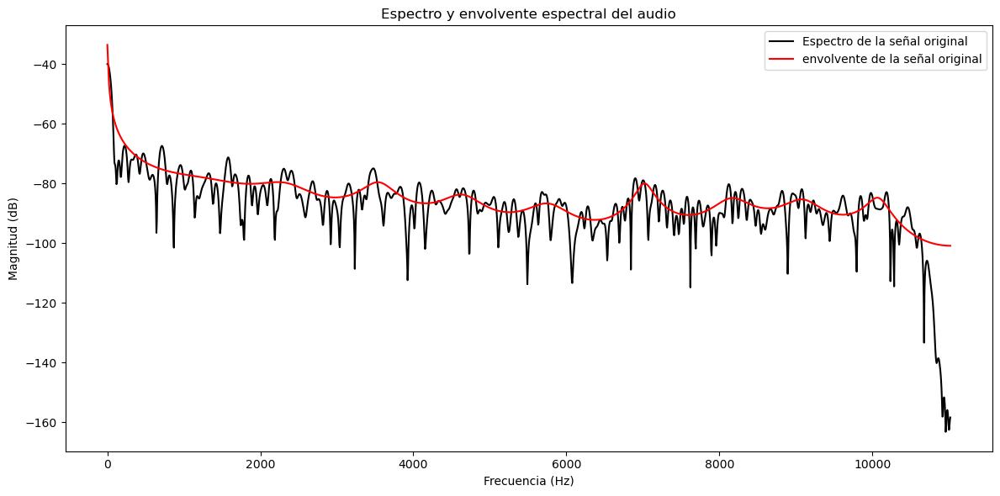

In [131]:
Ndft = 4056

H, X,f = get_envolvente(data,fs)

# magnitude spectrum
magH = np.abs(H)
ind_fmx = int(Ndft/2)
# magnitude spectrum
magX = np.abs(X)
ind_fmx = int(Ndft/2)

# plot the frequency response
plt.figure(figsize=(12,6))
ax1 = plt.subplot()
ax1.set_title('Espectro y envolvente espectral del audio')
ax1.plot(f[:ind_fmx], 20 * np.log10(magX[:ind_fmx]), 'k',label="Espectro de la señal original")
ax1.plot(f[:ind_fmx], 20 * np.log10(magH[:ind_fmx]), 'r',label="envolvente de la señal original")
ax1.set_ylabel('Magnitud (dB)')
ax1.set_xlabel('Frecuencia (Hz)')
plt.legend()
plt.tight_layout()


Emily pitch shifted

In [124]:
fs_ps, emily_pitch_shift = cargar_audio(dir_files, 'Emily_pitch_shift.wav', mono=True)

H_emily_shft, X_emily_shft,f_emily_shft = get_envolvente(emily_pitch_shift,fs_ps)

Audio(emily_pitch_shift, rate=fs)

C:\Users\victo\AppData\Local\Temp\ipykernel_21328\3344462408.py:12: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magX_emily_shft[:ind_fmx_emily_shft]), 'k',label="Espectro de la señal emily shifted",color='black')
C:\Users\victo\AppData\Local\Temp\ipykernel_21328\3344462408.py:13: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r" (-> color=(1.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magH_emily_shft[:ind_fmx_emily_shft]), 'r',label="Envolvente de emily shifted",color='red')
C:\Users\victo\AppData\Local\Temp\ipykernel_21328\3344462408.py:14: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword a

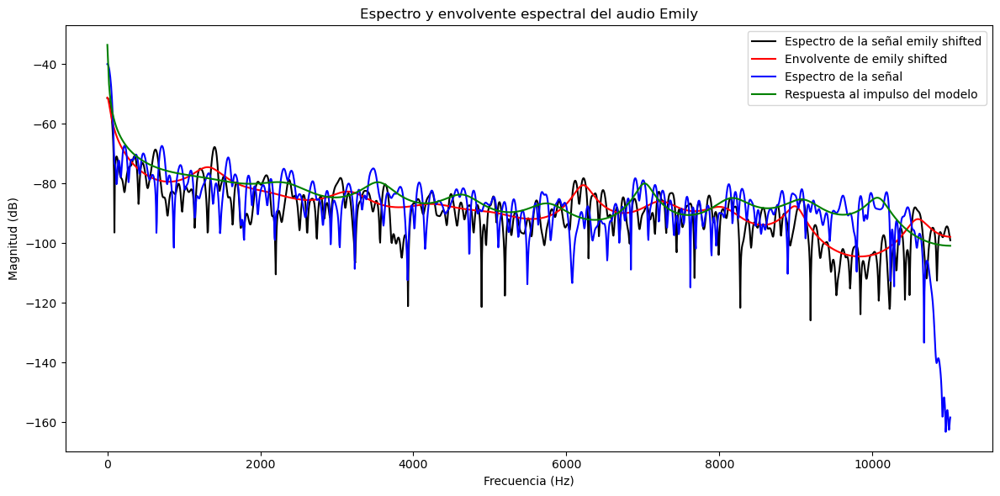

In [125]:
# magnitude spectrum
magH_emily_shft = np.abs(H_emily_shft)
ind_fmx_emily_shft = int(Ndft/2)
# magnitude spectrum
magX_emily_shft = np.abs(X_emily_shft )
ind_fmx_emily_shft = int(Ndft/2)

# plot the frequency response
plt.figure(figsize=(12,6))
ax1 = plt.subplot()
ax1.set_title('Espectro y envolvente espectral del audio Emily')
ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magX_emily_shft[:ind_fmx_emily_shft]), 'k',label="Espectro de la señal emily shifted",color='black')
ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magH_emily_shft[:ind_fmx_emily_shft]), 'r',label="Envolvente de emily shifted",color='red')
ax1.plot(f[:ind_fmx], 20 * np.log10(magX[:ind_fmx]), 'k',label="Espectro de la señal",color='blue')
ax1.plot(f[:ind_fmx], 20 * np.log10(magH[:ind_fmx]), 'r',label="Respuesta al impulso del modelo",color='green')
ax1.set_ylabel('Magnitud (dB)')
ax1.set_xlabel('Frecuencia (Hz)')
plt.legend()
plt.tight_layout()


### Corregir la envolvente del audio shifteado usando la envolvente del audio original

In [153]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt

## Cargar el archivo de audio
audio_path = "Emily_Linge-vocals.wav"  # Reemplaza con tu archivo
sr, y = cargar_audio(dir_files, 'Emily_pitch_shift.wav', mono=True)

# # STFT: Espectrograma complejo
n_fft = 2048
hop_length = 550
S = librosa.stft(y, n_fft=n_fft, hop_length=hop_length)
magnitude, phase = np.abs(S), np.angle(S)

# # Calcular la envolvente espectral
# # Promedio de las magnitudes por bandas de frecuencia
envelope = np.mean(magnitude, axis=1)

# Modificar la altura (pitch shifting)
n_steps = 2  # Cambia la altura en semitonos
y_shifted = librosa.effects.pitch_shift(y, sr=sr, n_steps=n_steps)

# Modified audio path
audio_path = "Emily_pitch_shift.wav"  # Reemplaza con tu archivo
sr, y_shifted = cargar_audio(dir_files, audio_path, mono=True)

# STFT del audio modificado
S_shifted = librosa.stft(y_shifted, n_fft=n_fft, hop_length=hop_length)
magnitude_shifted, phase_shifted = np.abs(S_shifted), np.angle(S_shifted)


##################################################################################


# Reconstruir la envolvente espectral en el audio modificado
# Normalizamos la envolvente original y la aplicamos a las magnitudes desplazadas
magnitude_reconstructed = (envelope[:, np.newaxis] / np.max(envelope)) * magnitude_shifted

# Reconstruir el espectrograma complejo
S_reconstructed = magnitude_reconstructed * np.exp(1j * phase_shifted)

# Inversa de STFT: Reconstrucción del audio
y_reconstructed = librosa.istft(S_reconstructed, hop_length=hop_length)

# # Graficar la comparación
# plt.figure(figsize=(12, 6))
# plt.subplot(2, 1, 1)
# librosa.display.specshow(librosa.amplitude_to_db(magnitude, ref=np.max), sr=sr, hop_length=hop_length, y_axis='log', x_axis='time')
# plt.title("Espectrograma Original")
# plt.colorbar(format="%+2.0f dB")

# plt.subplot(2, 1, 2)
# librosa.display.specshow(librosa.amplitude_to_db(magnitude_reconstructed, ref=np.max), sr=sr, hop_length=hop_length, y_axis='log', x_axis='time')
# plt.title("Espectrograma Reconstruido con Envolvente")
# plt.colorbar(format="%+2.0f dB")
# plt.tight_layout()
# plt.show()

# Guardar el audio modificado
# librosa.output.write_wav("audio_reconstructed.wav", y_reconstructed, sr)

import scipy.io.wavfile
scipy.io.wavfile.write("audio_reconstructed.wav", sr, y_reconstructed)


In [154]:
fs, data_reconstruida = cargar_audio(dir_files, "audio_reconstructed.wav", mono=True)

H_reconstruida, X_reconstruida, f_reconstruida = get_envolvente(data_reconstruida,fs)

Audio(data_reconstruida, rate=fs)

C:\Users\victo\AppData\Local\Temp\ipykernel_21328\2535625741.py:12: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f[:ind_fmx], 20 * np.log10(magX[:ind_fmx]), 'k',label="Espectro de la señal original",color='orange')
C:\Users\victo\AppData\Local\Temp\ipykernel_21328\2535625741.py:13: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r" (-> color=(1.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f[:ind_fmx], 20 * np.log10(magH[:ind_fmx]), 'r',label="envolvente original",color='purple')
C:\Users\victo\AppData\Local\Temp\ipykernel_21328\2535625741.py:16: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax1.plot(f_reconstruida[:ind_fmx_reconstruida], 20 * np.log10(mag

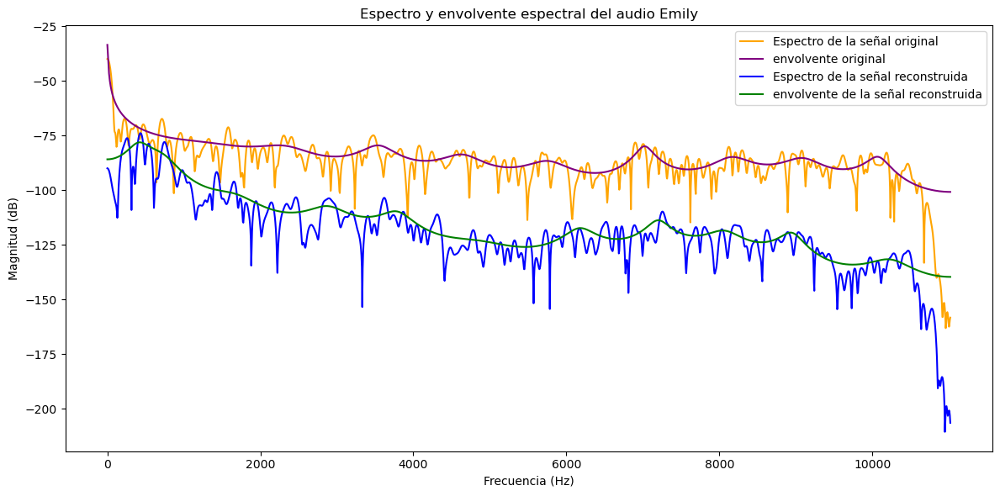

In [155]:
# magnitude spectrum
magH_reconstruida = np.abs(H_reconstruida)
ind_fmx_reconstruida = int(Ndft/2)
# magnitude spectrum
magX_reconstruida = np.abs(X_reconstruida )
ind_fmx_reconstruida = int(Ndft/2)

# plot the frequency response
plt.figure(figsize=(12,6))
ax1 = plt.subplot()
ax1.set_title('Espectro y envolvente espectral del audio Emily')
ax1.plot(f[:ind_fmx], 20 * np.log10(magX[:ind_fmx]), 'k',label="Espectro de la señal original",color='orange')
ax1.plot(f[:ind_fmx], 20 * np.log10(magH[:ind_fmx]), 'r',label="envolvente original",color='purple')
# ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magX_emily_shft[:ind_fmx_emily_shft]), 'k',label="Espectro de la señal emily shifted",color='black')
# ax1.plot(f_emily_shft[:ind_fmx_emily_shft], 20 * np.log10(magH_emily_shft[:ind_fmx_emily_shft]), 'r',label="envolvente emily shifted",color='red')
ax1.plot(f_reconstruida[:ind_fmx_reconstruida], 20 * np.log10(magX_reconstruida[:ind_fmx_reconstruida]), 'k',label="Espectro de la señal reconstruida",color='blue')
ax1.plot(f_reconstruida[:ind_fmx_reconstruida], 20 * np.log10(magH_reconstruida[:ind_fmx_reconstruida]), 'r',label="envolvente de la señal reconstruida",color='green')
ax1.set_ylabel('Magnitud (dB)')
ax1.set_xlabel('Frecuencia (Hz)')
plt.legend()
plt.tight_layout()
